In [317]:
# COMP4449
# Capstone
# Midterm Project
# Sam Roberts-Baca
# Spring Quarter 2022

import numpy as np
import pandas as pd

from pandas_profiling import ProfileReport
import sweetviz as sv

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt
%matplotlib inline

# Problem Statement

We are interested in determining what relationships exist between chart-topping songs and their musical characteristics.
We also want to know if songs that chart well in the United States will similarly chart well globally.

For this analysis, we will merge two Spotify webscraped datasets to answer the following research questions for chart-topping songs from 2017:

- Do globally top charting songs share similar characteristics? US Charting songs?
- If a song charts well in the United States, will it chart well worldwide?
- What are the most essential musical characteristics necessary to determine the number of streams a chart-topping song has?
- Can the number of streams a song has be predicted by its musical characteristics? US? Global?

# Data Preparation

In [318]:
# Spotify's Worldwide Daily Song Ranking dataset obtained from 
# https://www.kaggle.com/datasets/edumucelli/spotifys-worldwide-daily-song-ranking?resource=download

chart_dat = pd.read_csv('spotify_chart.csv')

# Data spans 1st January 2017 - 9th January 2018
# We will remove data points past 31st December 2017 since other dataset only includes songs from 2017
chart_dat = chart_dat[~chart_dat['Date'].str.contains('2018')]

# Remove 'global' region from dataset, as this significantly reduces observations in data
# We will prefer to group songs by summing total number of streams in each region
chart_dat = chart_dat[chart_dat['Region'] != 'global']

chart_dat.head()

,Position,Track Name,Artist,Streams,URL,Date,Region
0,1,Reggaetón Lento (Bailemos),CNCO,19272,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-01,ec
1,2,Chantaje,Shakira,19270,https://open.spotify.com/track/6mICuAdrwEjh6Y6...,2017-01-01,ec
2,3,Otra Vez (feat. J Balvin),Zion & Lennox,15761,https://open.spotify.com/track/3QwBODjSEzelZyV...,2017-01-01,ec
3,4,Vente Pa' Ca,Ricky Martin,14954,https://open.spotify.com/track/7DM4BPaS7uofFul...,2017-01-01,ec
4,5,Safari,J Balvin,14269,https://open.spotify.com/track/6rQSrBHf7HlZjtc...,2017-01-01,ec


In [319]:
# Group charting song data by number of streams across all regions

chart_sum_dat = chart_dat.groupby('Track Name', as_index=False, sort=False).agg({'Position':'min', 'Artist':'first', 'Streams':'sum','URL':'first'})
chart_sum_dat.head()

,Track Name,Position,Artist,Streams,URL
0,Reggaetón Lento (Bailemos),1,CNCO,199243294,https://open.spotify.com/track/3AEZUABDXNtecAO...
1,Chantaje,1,Shakira,301715956,https://open.spotify.com/track/6mICuAdrwEjh6Y6...
2,Otra Vez (feat. J Balvin),1,Zion & Lennox,208138398,https://open.spotify.com/track/3QwBODjSEzelZyV...
3,Vente Pa' Ca,2,Ricky Martin,135567686,https://open.spotify.com/track/7DM4BPaS7uofFul...
4,Safari,3,J Balvin,149854417,https://open.spotify.com/track/6rQSrBHf7HlZjtc...


In [320]:
# Spotify Song Attributes dataset obtained from
# https://www.kaggle.com/datasets/geomack/spotifyclassification

# Note that this dataset did not necessarily scrape top charting songs from 2017, 
# but still provided a decent overview of 2017 different songs selected from a wide variety of genres.

class_dat = pd.read_csv('spotify_classification.csv')
# remove first index column
class_dat = class_dat.iloc[: , 1:]
class_dat.head()

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target,song_title,artist
0,0.0102,0.833,204600,0.434,0.021900,2,0.1650,-8.795,1,0.4310,150.062,4,0.286,1,Mask Off,Future
1,0.1990,0.743,326933,0.359,0.006110,1,0.1370,-10.401,1,0.0794,160.083,4,0.588,1,Redbone,Childish Gambino
2,0.0344,0.838,185707,0.412,0.000234,2,0.1590,-7.148,1,0.2890,75.044,4,0.173,1,Xanny Family,Future
3,0.6040,0.494,199413,0.338,0.510000,5,0.0922,-15.236,1,0.0261,86.468,4,0.230,1,Master Of None,Beach House
4,0.1800,0.678,392893,0.561,0.512000,5,0.4390,-11.648,0,0.0694,174.004,4,0.904,1,Parallel Lines,Junior Boys


In [321]:
# Merged dataset for all songs across all dates & regions

dat = chart_dat.merge(class_dat, left_on=['Track Name'], right_on=['song_title'], how='inner')
# drop duplicate song_title and artist columns
dat = dat.iloc[:, :-2]
dat.head()

,Position,Track Name,Artist,Streams,URL,Date,Region,acousticness,danceability,duration_ms,...,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target
0,1,Reggaetón Lento (Bailemos),CNCO,19272,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-01,ec,0.4,0.761,222560,...,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
1,1,Reggaetón Lento (Bailemos),CNCO,16672,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-02,ec,0.4,0.761,222560,...,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
2,1,Reggaetón Lento (Bailemos),CNCO,17258,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-03,ec,0.4,0.761,222560,...,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
3,1,Reggaetón Lento (Bailemos),CNCO,18146,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-04,ec,0.4,0.761,222560,...,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
4,1,Reggaetón Lento (Bailemos),CNCO,17788,https://open.spotify.com/track/3AEZUABDXNtecAO...,2017-01-05,ec,0.4,0.761,222560,...,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0


In [322]:
len(dat)

823313

In [323]:
# Merged dataset for all songs by total streams per region

# remove rows with "global" region for counts
#region_dat = chart_dat[chart_dat['Region'] != 'global']

region_dat = chart_dat.groupby(['Track Name','Region'], as_index=False, sort=False).agg({'Position':'min', 'Artist':'first', 'Streams':'sum','URL':'first'})
region_dat = region_dat.merge(class_dat, left_on=['Track Name'], right_on=['song_title'], how='inner')
# drop duplicate song_title and artist columns
region_dat = region_dat.iloc[:, :-2]
region_dat.head()

,Track Name,Region,Position,Artist,Streams,URL,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target
0,Reggaetón Lento (Bailemos),ec,1,CNCO,3145541,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.4,0.761,222560,0.838,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
1,Reggaetón Lento (Bailemos),ar,1,CNCO,32228187,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.4,0.761,222560,0.838,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
2,Reggaetón Lento (Bailemos),it,44,CNCO,5982909,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.4,0.761,222560,0.838,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
3,Reggaetón Lento (Bailemos),sv,1,CNCO,989974,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.4,0.761,222560,0.838,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
4,Reggaetón Lento (Bailemos),cr,1,CNCO,3859248,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.4,0.761,222560,0.838,0.0,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0


In [324]:
len(region_dat)

6759

In [325]:
region_dat.to_csv('region_merged_data.csv', encoding='utf-8')

In [326]:
# Merged dataset for songs by total streams (no dates or regions included)

sum_dat = chart_sum_dat.merge(class_dat, left_on=['Track Name'], right_on=['song_title'], how='inner')
# drop duplicate song_title and artist columns
sum_dat = sum_dat.iloc[:, :-2]
# drop duplicate rows
sum_dat = sum_dat.drop_duplicates(subset='Track Name', keep="first")
sum_dat.head()

,Track Name,Position,Artist,Streams,URL,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target
0,Reggaetón Lento (Bailemos),1,CNCO,199243294,https://open.spotify.com/track/3AEZUABDXNtecAO...,0.40000,0.761,222560,0.838,0.000000,4,0.176,-3.073,0,0.0502,93.974,4,0.717,0
1,Chantaje,1,Shakira,301715956,https://open.spotify.com/track/6mICuAdrwEjh6Y6...,0.16800,0.859,195613,0.756,0.000047,8,0.163,-3.360,0,0.0643,102.033,4,0.913,0
2,Otra Vez (feat. J Balvin),1,Zion & Lennox,208138398,https://open.spotify.com/track/3QwBODjSEzelZyV...,0.05590,0.832,209453,0.772,0.000486,10,0.440,-5.429,1,0.1000,96.016,4,0.714,0
3,Vente Pa' Ca,2,Ricky Martin,135567686,https://open.spotify.com/track/7DM4BPaS7uofFul...,0.00431,0.663,259196,0.920,0.000017,11,0.101,-4.070,0,0.2260,99.935,4,0.521,0
4,Safari,3,J Balvin,149854417,https://open.spotify.com/track/6rQSrBHf7HlZjtc...,0.55100,0.508,205600,0.687,0.000003,0,0.126,-4.361,1,0.3260,180.044,4,0.565,0


In [327]:
len(sum_dat)

471

There were 471 total globally charting songs obtained that contained information in both datasets.

In [328]:
sum_dat.to_csv('merged_data.csv', encoding='utf-8')

In [329]:
# Merged dataset for chart topping songs in US

us_dat = region_dat[region_dat['Region'] == 'us']
# drop duplicate rows
us_dat = us_dat.drop_duplicates(subset='Track Name', keep="first")
us_dat.head()

,Track Name,Region,Position,Artist,Streams,URL,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target
39,Chantaje,us,51,Shakira,25646869,https://open.spotify.com/track/6mICuAdrwEjh6Y6...,0.1680,0.859,195613,0.756,0.000047,8,0.1630,-3.360,0,0.0643,102.033,4,0.913,0
287,Let Me Love You,us,9,DJ Snake,39695589,https://open.spotify.com/track/4pdPtRcBmOSQDlJ...,0.1630,0.622,249093,0.593,0.000000,7,0.0979,-8.352,0,0.0916,94.364,4,0.595,0
432,I Took A Pill In Ibiza - Seeb Remix,us,79,Mike Posner,15706346,https://open.spotify.com/track/17Fd6Yb7mSbinKG...,0.0331,0.678,198760,0.783,0.000015,7,0.1340,-4.672,0,0.0828,102.000,4,0.687,0
573,Work,us,48,Rihanna,15622927,https://open.spotify.com/track/14WWzenpaEgQZlq...,0.1520,0.726,178507,0.834,0.683000,10,0.0845,-5.564,1,0.0565,130.040,4,0.574,1
672,Trumpets,us,190,Jason Derulo,166027,https://open.spotify.com/track/6jizk5lOUnfpaZX...,0.5550,0.635,217419,0.691,0.000000,0,0.0970,-4.862,1,0.2580,82.142,4,0.630,0


In [330]:
len(us_dat)

168

There were 168 total US charting songs obtained that contained information in both datasets.

# Exploratory Data Analysis

## Globally Charting Songs

In [331]:
# Profile Report generated with Pandas Profiling
profile = ProfileReport(sum_dat, title="Global Pandas Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

                                             |         | [  0%]   00:00 -> (? left)


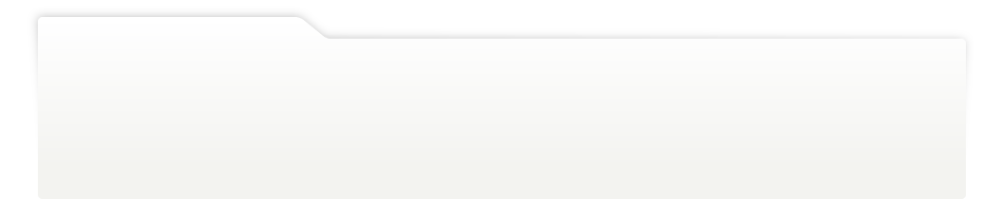
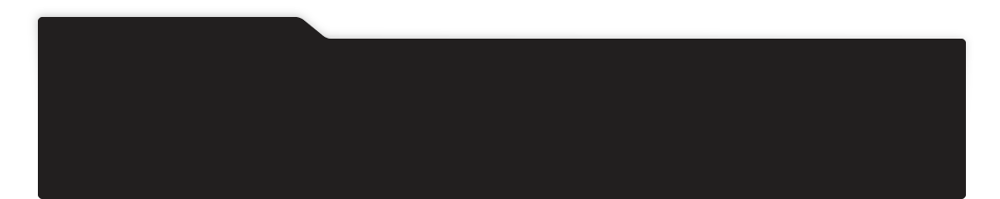
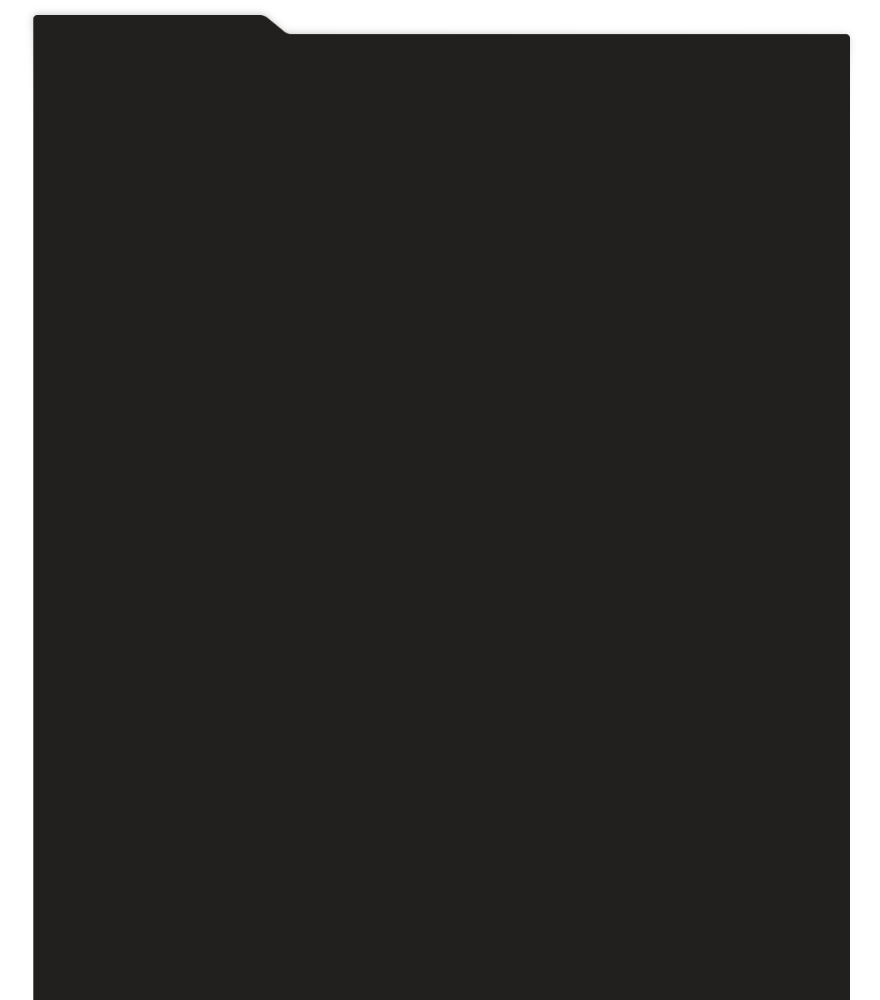
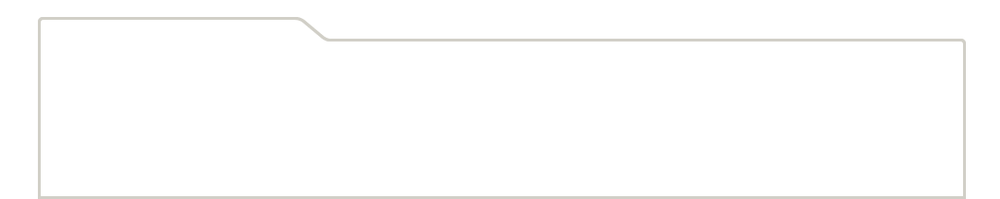
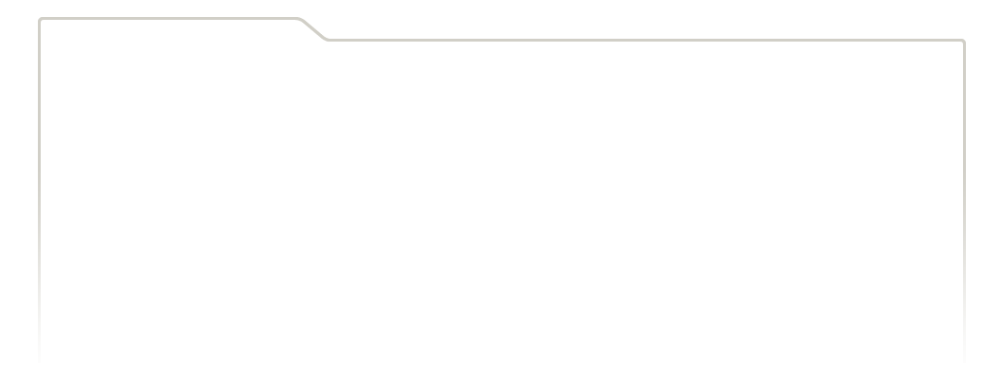
...
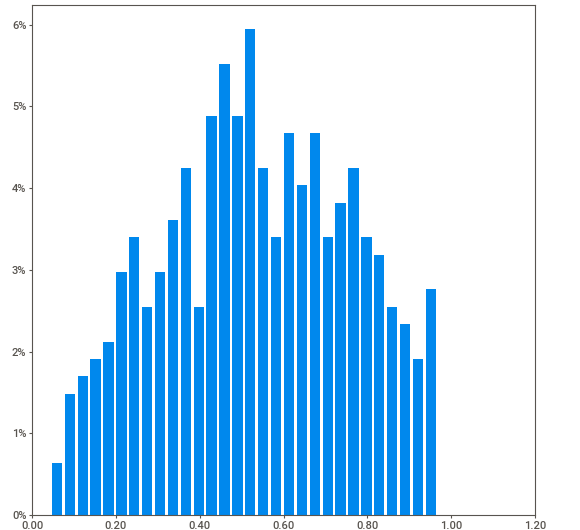
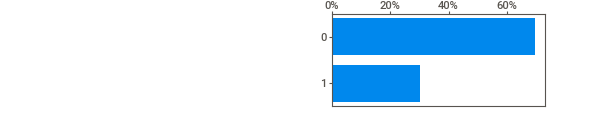
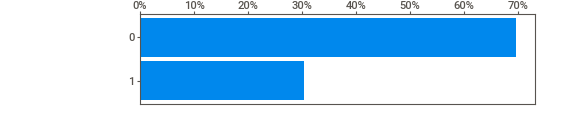
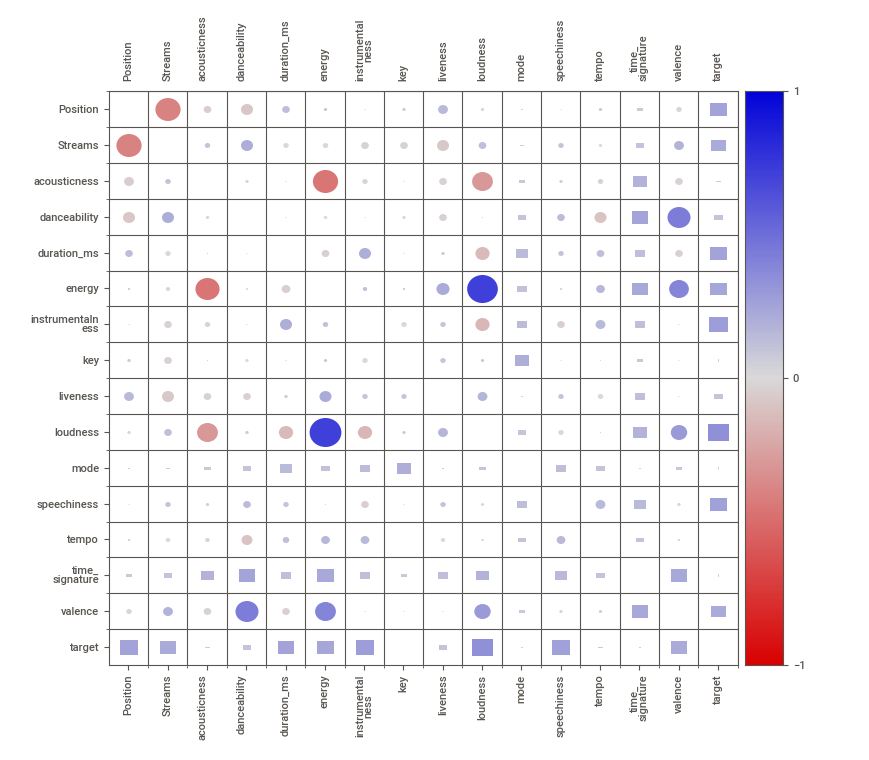
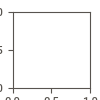

In [332]:
# Exploratory Analysis Report generated using SweetViz
report2 = sv.analyze(sum_dat)
report2.show_notebook()

Globally charting songs - observations of note:
- No missing values in dataset.
- Energy and loudness are strongly correlated
- Energy and acousticness are somewhat negatively correlated (which is to be expected)
- Streams and Position are strongly negatively correlated (which is to be expected, the more streams, the greater likelihood a song will be higher in the charts)
- Vast majority of chart topping songs are in 4/4 time signature
- Danceability of songs appears to follow a left skewed normal distribution
- Duration of songs appears to follow a somewhat right skewed normal distribution, mean at ~ 230078 ms (~ 3.83 minutes)
- Acousticness appears to follow exponential distribution (most chart topping songs are not acoustic)
- Key of highest charting songs fairly uniform distribution, with 16% of songs being in key of C#/Db, and 2.5% of songs being in key of D#/Eb.
- Vast majority of charting songs not acoustic.

In [333]:
# Chart top 30 songs of 2017

sum_dat_subset = sum_dat.sort_values(by=['Streams'], ascending=False).head(30)

fig = px.bar(sum_dat_subset, x="Track Name", y="Streams", title="Top 30 Globally Charting Songs of 2017 by Streams")
fig.show()

In [474]:
# Chart top 30 songs of 2017 for US

us_dat_subset = us_dat.sort_values(by=['Streams'], ascending=False).head(30)

fig = px.bar(us_dat_subset, x="Track Name", y="Streams", title="Top 30 US Charting Songs of 2017 by Streams")
fig.show()

In [475]:
fig = px.histogram(sum_dat, x="Streams", marginal="violin", title="Distribution of Streams for Globally Charting Songs of 2017")
fig.show()

In [476]:
fig = px.histogram(us_dat, x="Streams", marginal="violin", title="Distribution of Streams for US Charting Songs of 2017")
fig.show()

## United States Charting Songs

In [335]:
# US Charting Songs Profile Report generated with Pandas Profiling
us_profile = ProfileReport(us_dat, title="US Pandas Profiling Report", explorative=True)
us_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

                                             |         | [  0%]   00:00 -> (? left)


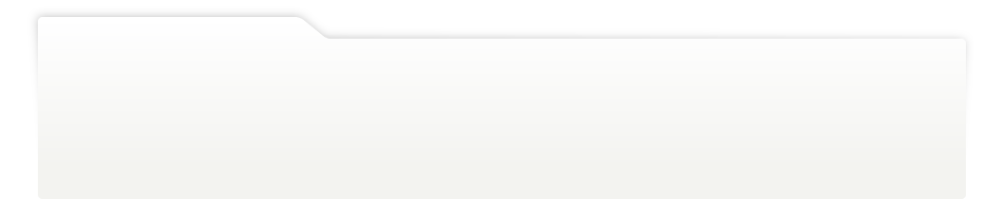
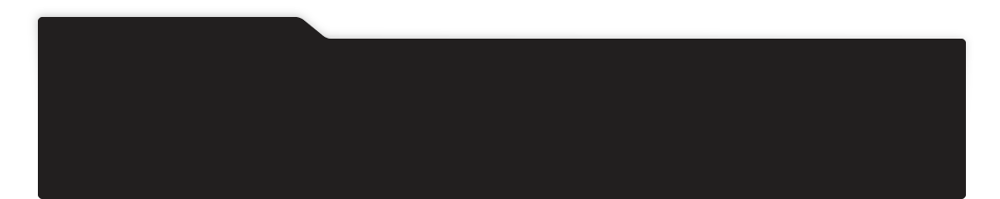
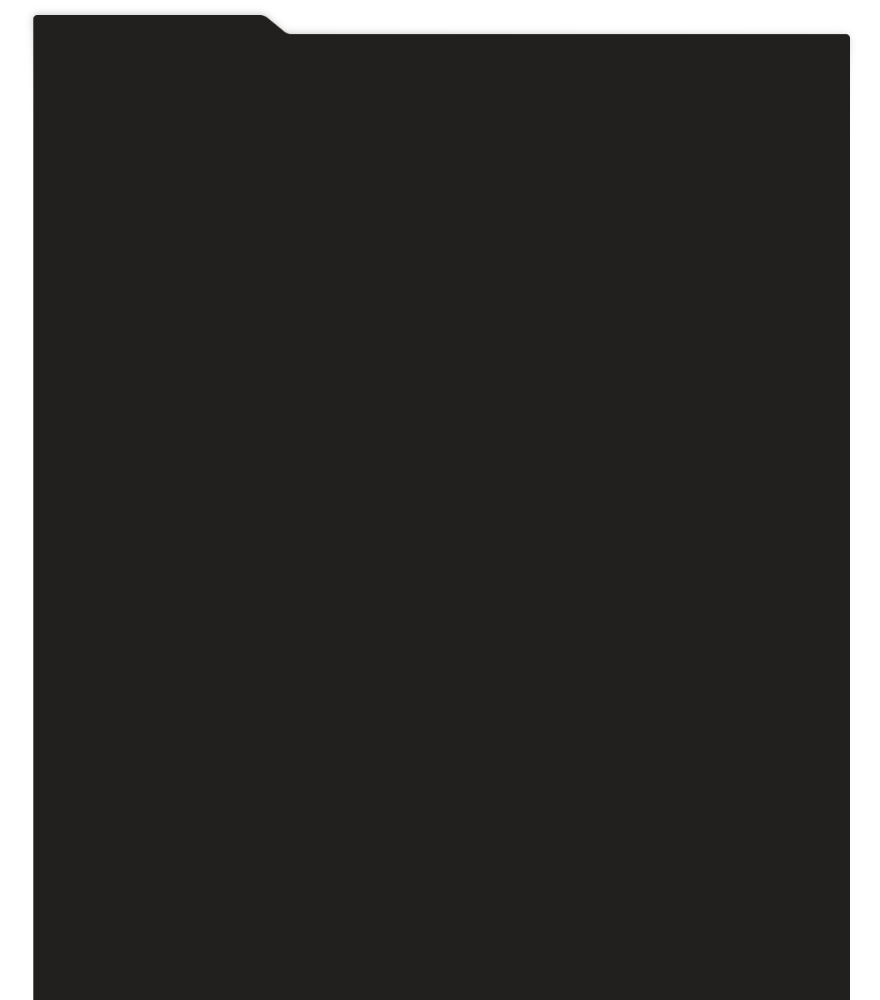
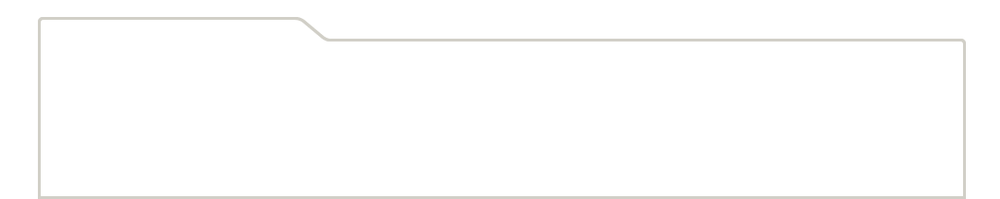
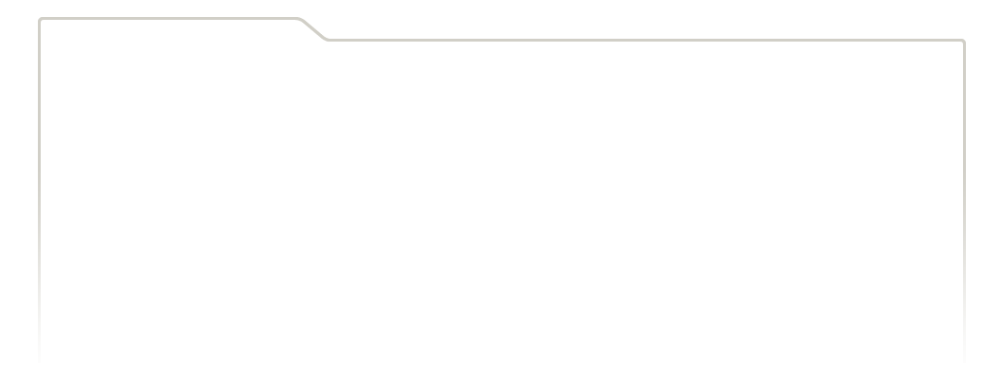
...
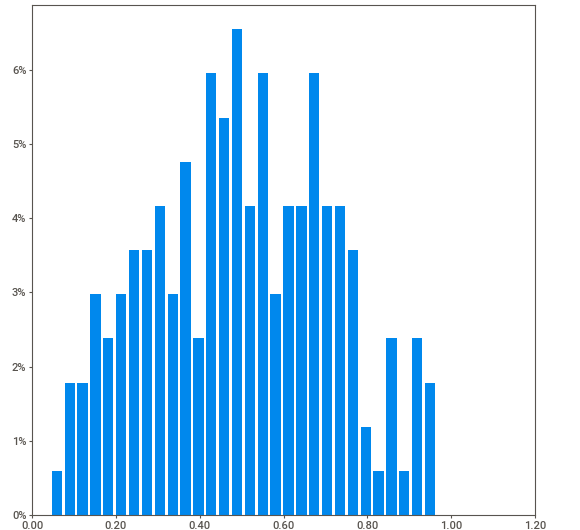
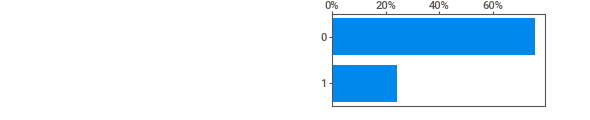
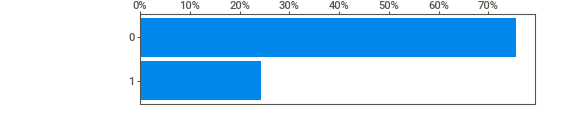
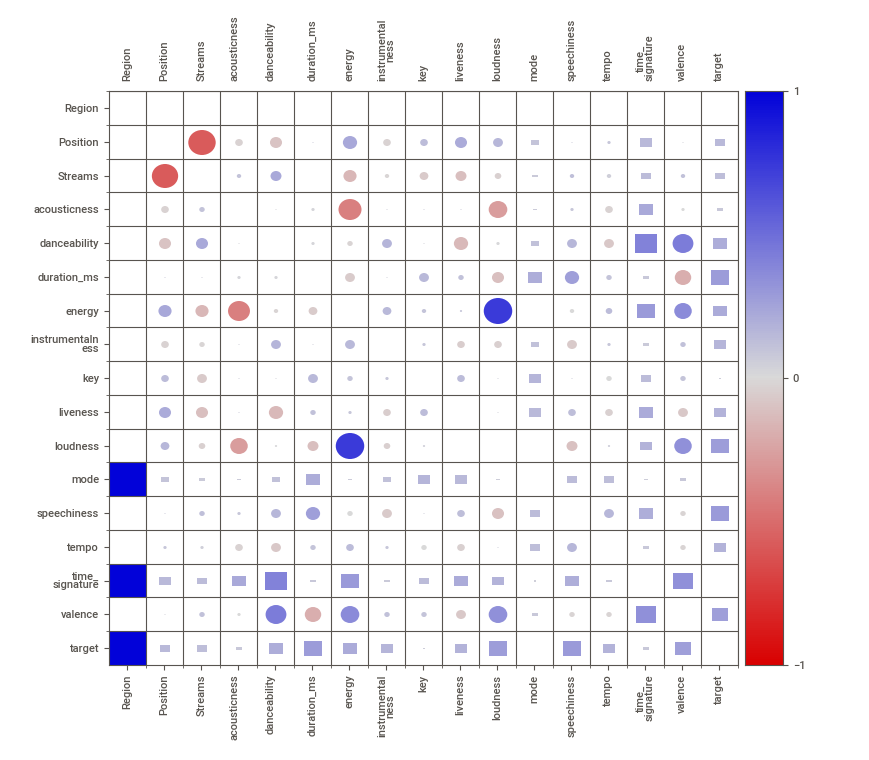
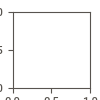

In [336]:
# Exploratory Analysis Report generated using SweetViz
us_report2 = sv.analyze(us_dat)
us_report2.show_notebook()

Observations of US Dataset:
- No missing values.
- The distributions of musical characteristics for US charting songs appear to be similar to those of the global dataset. We can confirm this by visually plotting overlaying histograms for both datasets.

In [337]:
# Compare musical characteristic distributions between US and Global datasets

cols = ['acousticness',
       'danceability', 'duration_ms', 'energy', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=4,cols=3,
                   subplot_titles=('acousticness','instrumentalness','mode',
                                   'speechiness','danceability','key',
                                   'liveness','tempo','duration_ms',
                                   'energy','loudness','valence'))
traces = []

index = 1
for col in cols:

    tracea = go.Histogram(x=sum_dat[col],name='Global',marker_color='red',bingroup=index)
    traceb = go.Histogram(x=us_dat[col],name='US',marker_color='blue',bingroup=index)
    traces.append((tracea,traceb))
    index +=1
    
for i in range(12):
    fig.append_trace(traces[i][0],(i%4)+1,(i%3)+1)
    fig.append_trace(traces[i][1],(i%4)+1,(i%3)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Global vs. US Chart Topping Song Characteristics'
)

fig.show()

# Data Analysis

In [338]:
# Testing multicollinearity in feature variables
sum_dat.cov()

,Position,Streams,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,target
Position,3.633306e+03,-3.719810e+09,-1.231681e+00,-1.091837e+00,2.575838e+05,4.069805e-01,-7.751285e-02,6.051389e+00,8.900809e-01,-4.688924e+00,-0.097100,-0.087664,5.707088e+01,0.180982,-8.097105e-01,5.951168e+00
Streams,-3.719810e+09,1.926481e+16,1.504471e+06,3.166381e+06,-3.509016e+11,-1.185044e+06,-1.564988e+06,-3.981131e+07,-2.426206e+06,2.635690e+07,-998962.882667,594627.168449,-1.640806e+08,301095.318629,4.010330e+06,-1.088262e+07
acousticness,-1.231681e+00,1.504471e+06,4.032193e-02,-8.192979e-04,1.491545e+02,-1.714981e-02,-1.896733e-03,1.034570e-02,-2.090199e-03,-1.717576e-01,0.003274,-0.000011,-4.126600e-01,-0.003775,-3.555627e-03,-1.984013e-03
danceability,-1.091837e+00,3.166381e+06,-8.192979e-04,1.864199e-02,5.073428e+01,-9.250155e-04,-3.618164e-04,-1.760802e-02,-1.562149e-03,9.822305e-03,-0.003440,0.001175,-5.665558e-01,0.001812,1.219046e-02,3.552284e-03
duration_ms,2.575838e+05,-3.509016e+11,1.491545e+02,5.073428e+01,2.808080e+09,-8.671759e+02,1.251120e+03,2.761370e+03,2.216095e+02,-2.442072e+04,-2600.359669,280.706798,1.127710e+05,16.735619,-1.025491e+03,5.132827e+03
energy,4.069805e-01,-1.185044e+06,-1.714981e-02,-9.250155e-04,-8.671759e+02,2.789328e-02,1.576975e-03,2.434774e-02,3.945041e-03,2.896300e-01,-0.005485,-0.000115,5.125522e-01,0.004995,1.358093e-02,-1.484357e-02
instrumentalness,-7.751285e-02,-1.564988e+06,-1.896733e-03,-3.618164e-04,1.251120e+03,1.576975e-03,2.242391e-02,-2.710211e-02,9.831208e-04,-7.531014e-02,-0.006676,-0.001251,4.471480e-01,-0.002316,-1.657275e-04,1.635529e-02
key,6.051389e+00,-3.981131e+07,1.034570e-02,-1.760802e-02,2.761370e+03,2.434774e-02,-2.710211e-02,1.312644e+01,2.068887e-02,3.195676e-01,-0.273641,0.003953,-1.928010e+00,-0.019108,-7.115544e-03,-9.215341e-04
liveness,8.900809e-01,-2.426206e+06,-2.090199e-03,-1.562149e-03,2.216095e+02,3.945041e-03,9.831208e-04,2.068887e-02,1.860740e-02,4.246102e-02,-0.000269,0.000584,-1.883932e-01,-0.000359,-5.223557e-04,3.229135e-03
loudness,-4.688924e+00,2.635690e+07,-1.717576e-01,9.822305e-03,-2.442072e+04,2.896300e-01,-7.531014e-02,3.195676e-01,4.246102e-02,6.117932e+00,-0.051557,-0.011054,9.788058e-01,0.055303,1.404741e-01,-3.450132e-01


In general there is very little covariance exhibited in the data, with the exception of the time signature/duration_ms value. We will remove both variables from our dataset for further analysis.
We will remove time_signature from our feature set, as 95% of chart topping songs are in 4/4.

We will also remove instrumentalness from our feature set, as it is clear the overwhelming majority of chart topping songs are not instrumental.

The target variable will also be removed, as it expresses whether or not the data collector liked the song (1/0) and will not be used for this analysis.

In [339]:
# Can songs be categorized by their musical characteristics?
# We will employ PCA to attempt to answer this question.

from sklearn import preprocessing as pre
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# We will scale musical feature columns using a Min-Max Scaler.
X = sum_dat.copy()
y = X['Streams']
X = X[['acousticness','danceability','energy','key',
       'liveness','loudness','mode','speechiness','tempo','valence']]

#scaler = MinMaxScaler(feature_range=(0,1))
#X = scaler.fit_transform(X)
#X = pd.DataFrame(X,columns=['acousticness','danceability','energy','key',
#       'liveness','loudness','mode','speechiness','tempo','valence'])
#X.head()

In [340]:
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering

# Conduct a principal component analysis
pca = PCA(n_components=2)
pca = pca.fit(X)
X_pca = pca.transform(X)
X_pca.shape

X_pca_labels = pd.DataFrame(X_pca,columns=['x','y'])
X_pca_labels['Track Name'] = sum_dat['Track Name']

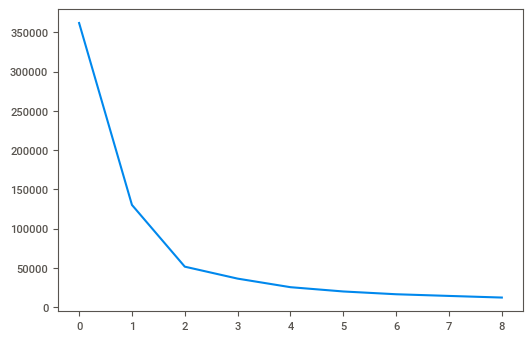

In [341]:
from sklearn import cluster

# use a loop and a plot to determine the number of clusters we should use (Elbow plot)
n_clusters = list(range(1, 10))
within_cluster_var = []
for i in n_clusters:
    clu = cluster.KMeans(n_clusters=i)
    clu = clu.fit(X_pca)
    within_cluster_var.append(clu.inertia_)

plt.plot(within_cluster_var)
plt.show()

From this elbow plot, 4 clusters appears to be a decent number of clusters to choose for our K Means clustering algorithm, as the plot seems to level off around this point.

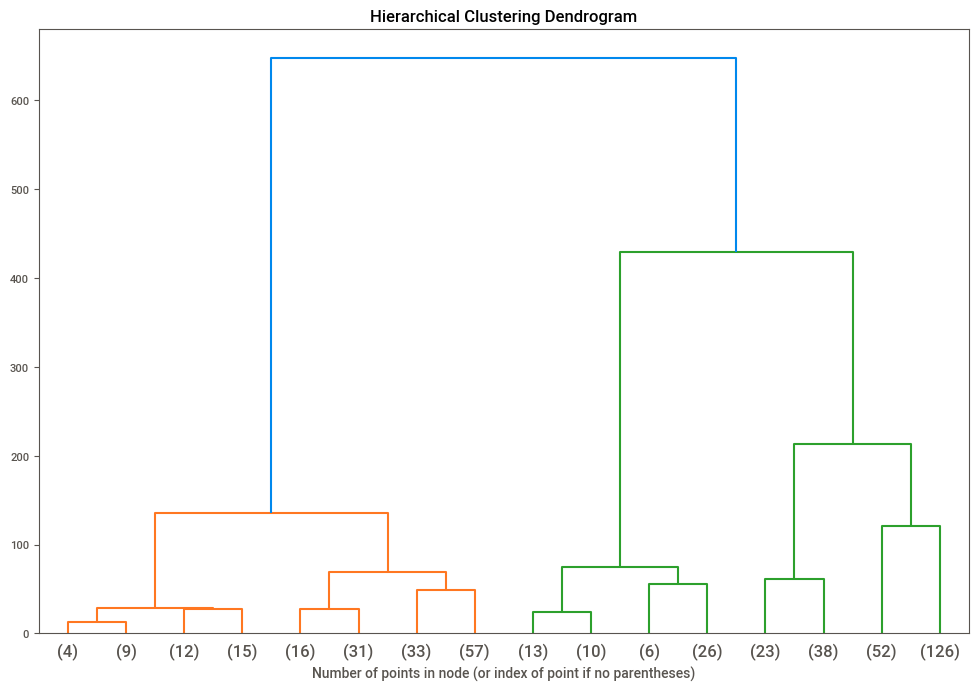

In [342]:
# Construct a dendrogram using agglomerative clustering

from scipy.cluster.hierarchy import dendrogram

def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram
 
    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
 
    linkage_matrix = np.column_stack([model.children_, model.distances_,counts]).astype(float)
 
    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)
 
 
# setting distance_threshold=0 ensures we compute the full tree.
model = cluster.AgglomerativeClustering(distance_threshold=0,n_clusters=None)
 
model = model.fit(X_pca)

fig, ax = plt.subplots(figsize=(12,8)) 
plt.title('Hierarchical Clustering Dendrogram')

# plot the top three levels of the dendrogram 
plot_dendrogram(model, truncate_mode='level', p=3,ax=ax)
 
plt.xlabel("Number of points in node (or index of point if no parentheses)")
plt.show();

Here it appears that four clusters would be appropriate, if we cut the dendrogram where the value on the vertical axis is roughly 150. This parallels the number of clusters determined using our elbow plot.

In [461]:
# Conduct a principal component analysis with 4 components
pca = PCA(n_components=4)
pca = pca.fit(X)
X_pca = pca.transform(X)
X_pca.shape

(471, 4)

## K-Means

In [462]:
# implement a kmeans clustering to find the clusters in the data

clu = cluster.KMeans(n_clusters=4)
clu = clu.fit(X_pca)

# predict the clusters
y_pred = clu.predict(X_pca)
y_pred

y_pred_str = list(map(str,  y_pred))

fig = px.scatter(X_pca_labels,x='x',y='y',
                    color=y_pred_str,title='Clustering Globally Chart Topping Songs using K-Means',
                   width=600,height=600, 
        labels=dict(x="x", y="y", color="Song Cluster",track_name='Track Name'))
fig.update_traces(marker_size=10)
fig.show()


In [463]:
X_labels = X.copy()
X_labels['y_pred'] = y_pred
X_labels = X_labels.sort_values(by=['y_pred'], ascending=False)
X_kmeans = X_labels.copy()
X_labels

X_g0 = X_labels[X_labels['y_pred'] == 0]
X_g1 = X_labels[X_labels['y_pred'] == 1]
X_g2 = X_labels[X_labels['y_pred'] == 2]
X_g3 = X_labels[X_labels['y_pred'] == 3]

cols = ['acousticness',
       'danceability', 'energy', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=5,cols=2,
                   subplot_titles=('acousticness', 'loudness',
                                'mode','danceability',
                                'energy','speechiness',
                                'tempo','key',
                                'liveness','valence'))
traces = []

for col in cols:

    tracea = go.Scatter(x=X_g0[col],name='Cluster 0',marker_color='red',mode='markers')
    traceb = go.Scatter(x=X_g1[col],name='Cluster 1',marker_color='blue',mode='markers')
    tracec = go.Scatter(x=X_g2[col],name='Cluster 2',marker_color='lime',mode='markers')
    traced = go.Scatter(x=X_g3[col],name='Cluster 3',marker_color='orange',mode='markers')
    
    traces.append((tracea,traceb,tracec,traced))
    
for i in range(10):
    fig.append_trace(traces[i][0],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][1],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][2],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][3],(i%5)+1,(i%2)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Clustered Song Characteristics using K-Means Clustering'
)

fig.show()



The most obvious characteristic of which songs can be categorized into via K-means is mode, which makes sense as this feature can only take on values of 1 or 0. We can also see that K-means with n_clusters set to 4 creates categories of songs dillineated evenly by tempo.

## Affinity Propagation

In [464]:
# affinity propagation clustering
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import AffinityPropagation
from matplotlib import pyplot

# Fit AFfinity Propagation with Scikit
afprop = AffinityPropagation(max_iter=250, damping=0.9)
afprop.fit(X_pca)
cluster_centers_indices = afprop.cluster_centers_indices_
n_clusters_ = len(cluster_centers_indices)

# Predict the cluster for all the samples
P = afprop.predict(X_pca)
P_str = list(map(str,  P))

# Generate scatter plot for training data
fig = px.scatter(x=X_pca[:,0],y=X_pca[:,1],
                    color=P_str,title='Clustering Globally Chart Topping Songs using Affinity Propogation',
                   width=600,height=600, 
        labels=dict(x="x", y="y", color="Song Cluster"))
fig.update_traces(marker_size=10)
fig.show()

C:\Users\Sam\anaconda3\lib\site-packages\sklearn\cluster\_affinity_propagation.py:146: FutureWarning:

'random_state' has been introduced in 0.23. It will be set to None starting from 0.25 which means that results will differ at every function call. Set 'random_state' to None to silence this warning, or to 0 to keep the behavior of versions <0.23.



In [465]:
X_labels = X.copy()
X_labels['y_pred'] = P
X_labels = X_labels.sort_values(by=['y_pred'], ascending=False)
X_aff = X_labels.copy()
X_labels

X_g0 = X_labels[X_labels['y_pred'] == 0]
X_g1 = X_labels[X_labels['y_pred'] == 1]
X_g2 = X_labels[X_labels['y_pred'] == 2]
X_g3 = X_labels[X_labels['y_pred'] == 3]
X_g4 = X_labels[X_labels['y_pred'] == 4]
X_g5 = X_labels[X_labels['y_pred'] == 5]
X_g6 = X_labels[X_labels['y_pred'] == 6]
X_g7 = X_labels[X_labels['y_pred'] == 7]
X_g8 = X_labels[X_labels['y_pred'] == 8]
X_g9 = X_labels[X_labels['y_pred'] == 9]
X_g10 = X_labels[X_labels['y_pred'] == 10]
X_g11 = X_labels[X_labels['y_pred'] == 11]
X_g12 = X_labels[X_labels['y_pred'] == 12]
X_g13 = X_labels[X_labels['y_pred'] == 13]

cols = ['acousticness',
       'danceability', 'energy', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=5,cols=2,
                   subplot_titles=('acousticness', 'loudness',
                                'mode','danceability',
                                'energy','speechiness',
                                'tempo','key',
                                'liveness','valence'))
traces = []

for col in cols:

    tracea = go.Scatter(x=X_g0[col],name='Cluster 0',marker_color='red',mode='markers')
    traceb = go.Scatter(x=X_g1[col],name='Cluster 1',marker_color='orange',mode='markers')
    tracec = go.Scatter(x=X_g2[col],name='Cluster 2',marker_color='yellow',mode='markers')
    traced = go.Scatter(x=X_g3[col],name='Cluster 3',marker_color='lime',mode='markers')
    
    tracee = go.Scatter(x=X_g4[col],name='Cluster 4',marker_color='green',mode='markers')
    tracef = go.Scatter(x=X_g5[col],name='Cluster 5',marker_color='aqua',mode='markers')
    traceg = go.Scatter(x=X_g6[col],name='Cluster 6',marker_color='blue',mode='markers')
    traceh = go.Scatter(x=X_g7[col],name='Cluster 7',marker_color='turquoise',mode='markers')
    
    tracei = go.Scatter(x=X_g8[col],name='Cluster 8',marker_color='pink',mode='markers')
    tracej = go.Scatter(x=X_g9[col],name='Cluster 9',marker_color='purple',mode='markers')
    tracek = go.Scatter(x=X_g10[col],name='Cluster 10',marker_color='brown',mode='markers')
    tracel = go.Scatter(x=X_g11[col],name='Cluster 11',marker_color='black',mode='markers')
    
    tracem = go.Scatter(x=X_g12[col],name='Cluster 12',marker_color='white',mode='markers')
    tracen = go.Scatter(x=X_g13[col],name='Cluster 13',marker_color='gray',mode='markers')
    
    traces.append((tracea,traceb,tracec,traced,tracee,tracef,traceg,traceh,tracei,
                  tracej,tracek,tracel,tracem,tracen))
    
for i in range(10):
    fig.append_trace(traces[i][0],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][1],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][2],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][3],(i%5)+1,(i%2)+1)
    
    fig.append_trace(traces[i][4],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][5],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][6],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][7],(i%5)+1,(i%2)+1)
    
    fig.append_trace(traces[i][8],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][9],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][10],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][11],(i%5)+1,(i%2)+1)
    
    fig.append_trace(traces[i][12],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][13],(i%5)+1,(i%2)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Clustered Song Characteristics using Affinity Propogation'
)

fig.show()



## Birch

In [466]:
from sklearn.cluster import Birch

# define the model
model = Birch(threshold=0.01, n_clusters=4)
# fit the model
model.fit(X_pca)
# assign a cluster to each example
P = model.predict(X_pca)
P_str = list(map(str,  P))
# retrieve unique clusters
clusters = unique(P)

# Generate scatter plot for training data
fig = px.scatter(x=X_pca[:,0],y=X_pca[:,1],
                    color=P_str,title='Clustering Globally Chart Topping Songs using Birch Model',
                   width=600,height=600, 
        labels=dict(x="x", y="y", color="Song Cluster"))
fig.update_traces(marker_size=10)
fig.show()


In [467]:
X_labels = X.copy()
X_labels['y_pred'] = P
X_labels = X_labels.sort_values(by=['y_pred'], ascending=False)
X_birch = X_labels.copy()
X_labels

X_g0 = X_labels[X_labels['y_pred'] == 0]
X_g1 = X_labels[X_labels['y_pred'] == 1]
X_g2 = X_labels[X_labels['y_pred'] == 2]
X_g3 = X_labels[X_labels['y_pred'] == 3]

cols = ['acousticness',
       'danceability', 'energy', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=5,cols=2,
                   subplot_titles=('acousticness', 'loudness',
                                'mode','danceability',
                                'energy','speechiness',
                                'tempo','key',
                                'liveness','valence'))
traces = []

for col in cols:

    tracea = go.Scatter(x=X_g0[col],name='Cluster 0',marker_color='red',mode='markers')
    traceb = go.Scatter(x=X_g1[col],name='Cluster 1',marker_color='blue',mode='markers')
    tracec = go.Scatter(x=X_g2[col],name='Cluster 2',marker_color='lime',mode='markers')
    traced = go.Scatter(x=X_g3[col],name='Cluster 3',marker_color='orange',mode='markers')
    
    traces.append((tracea,traceb,tracec,traced))
    
for i in range(10):
    fig.append_trace(traces[i][0],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][1],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][2],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][3],(i%5)+1,(i%2)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Clustered Song Characteristics using Birch'
)

fig.show()



## Gaussian Mixture Model

In [468]:
from sklearn.mixture import GaussianMixture

# define the model
model = GaussianMixture(n_components=4)
# fit the model
model.fit(X_pca)
# assign a cluster to each example
P = model.predict(X_pca)

P_str = list(map(str,  P))
# retrieve unique clusters
clusters = unique(P)

# Generate scatter plot for training data
fig = px.scatter(x=X_pca[:,0],y=X_pca[:,1],
                    color=P_str,title='Clustering Globally Chart Topping Songs using Gaussian Mixture',
                   width=600,height=600, 
        labels=dict(x="x", y="y", color="Song Cluster"))
fig.update_traces(marker_size=10)
fig.show()



In [469]:
X_labels = X.copy()
X_labels['y_pred'] = P
X_labels = X_labels.sort_values(by=['y_pred'], ascending=False)
X_gmm = X_labels.copy()
X_labels

X_g0 = X_labels[X_labels['y_pred'] == 0]
X_g1 = X_labels[X_labels['y_pred'] == 1]
X_g2 = X_labels[X_labels['y_pred'] == 2]
X_g3 = X_labels[X_labels['y_pred'] == 3]

cols = ['acousticness',
       'danceability', 'energy', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=5,cols=2,
                   subplot_titles=('acousticness', 'loudness',
                                'mode','danceability',
                                'energy','speechiness',
                                'tempo','key',
                                'liveness','valence'))
traces = []

for col in cols:

    tracea = go.Scatter(x=X_g0[col],name='Cluster 0',marker_color='red',mode='markers')
    traceb = go.Scatter(x=X_g1[col],name='Cluster 1',marker_color='blue',mode='markers')
    tracec = go.Scatter(x=X_g2[col],name='Cluster 2',marker_color='lime',mode='markers')
    traced = go.Scatter(x=X_g3[col],name='Cluster 3',marker_color='orange',mode='markers')
    
    traces.append((tracea,traceb,tracec,traced))
    
for i in range(10):
    fig.append_trace(traces[i][0],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][1],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][2],(i%5)+1,(i%2)+1)
    fig.append_trace(traces[i][3],(i%5)+1,(i%2)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Clustered Song Characteristics using GMM'
)

fig.show()

# 

In [471]:
# Testing clustering algorithms using logistic regression model for accuracy

from sklearn.linear_model import LogisticRegression

X_features = X_kmeans.copy()
y_labels = X_features.pop('y_pred')

lr_model = LogisticRegression(max_iter=10000)
lr_model.fit(X_features,y_labels)

print('K-Means Logistic Regression Model Accuracy:',lr_model.score(X_features, y_labels))

X_features = X_aff.copy()
y_labels = X_features.pop('y_pred')

lr_model = LogisticRegression(max_iter=10000)
lr_model.fit(X_features,y_labels)

print('Affinity Propagation Logistic Regression Model Accuracy:',lr_model.score(X_features, y_labels))

X_features = X_birch.copy()
y_labels = X_features.pop('y_pred')

lr_model = LogisticRegression(max_iter=10000)
lr_model.fit(X_features,y_labels)

print('Birch Logistic Regression Model Accuracy:',lr_model.score(X_features, y_labels))

X_features = X_gmm.copy()
y_labels = X_features.pop('y_pred')

lr_model = LogisticRegression(max_iter=10000)
lr_model.fit(X_features,y_labels)

print('GMM Logistic Regression Model Accuracy:',lr_model.score(X_features, y_labels))


K-Means Logistic Regression Model Accuracy: 1.0


C:\Users\Sam\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Affinity Propagation Logistic Regression Model Accuracy: 0.8237791932059448
Birch Logistic Regression Model Accuracy: 0.9893842887473461
GMM Logistic Regression Model Accuracy: 0.9723991507430998


## Linear Regression

In [416]:
# split charting songs into test/train set

X = sum_dat.copy()
y = X['Streams']
X = X[['acousticness','danceability','energy','key',
       'liveness','loudness','mode','speechiness','tempo','valence']]

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    np.log(y), 
                                                    test_size=0.33, 
                                                    shuffle=True)
print('X_train shape:',X_train.shape)
print('y_train shape:',y_train.shape)
print('X_test shape:',X_test.shape)
print('y_test shape:',y_test.shape)

X_train shape: (315, 10)
y_train shape: (315,)
X_test shape: (156, 10)
y_test shape: (156,)


In [417]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
import statsmodels.api as sm

model = LinearRegression()
model.fit(X_train,y_train)

#y_train_a = y_train.values.reshape(-1,1)
model_sm = sm.OLS(y_train,X_train)
res = model_sm.fit()
print(res.summary())
print()


y_pred_train = model.predict(X_train)
y_pred = model.predict(X_test)
mse_train = mean_squared_error(y_train, y_pred_train, squared=True)
mse_test = mean_squared_error(y_test, y_pred, squared=True)

print('Training MSE:', mse_train)
print('Testing MSE:', mse_test)
print('Training R2:',  r2_score(y_train, y_pred_train))
print('Testing R2:',  r2_score(y_test, y_pred))



                                 OLS Regression Results                                
Dep. Variable:                Streams   R-squared (uncentered):                   0.939
Model:                            OLS   Adj. R-squared (uncentered):              0.937
Method:                 Least Squares   F-statistic:                              465.7
Date:                Tue, 26 Apr 2022   Prob (F-statistic):                   3.43e-178
Time:                        19:14:37   Log-Likelihood:                         -856.05
No. Observations:                 315   AIC:                                      1732.
Df Residuals:                     305   BIC:                                      1770.
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
                   coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------

Our initial log-linear regression model is a good fit. Let's see if we can find an optimal model using forward stepwise model selection.

In [418]:
import itertools

def fit_linear_reg(X,y):
    #Fit linear regression model and return RSS and R squared values
    model_k = LinearRegression(fit_intercept = True)

    model_k.fit(X,y)
    RSS = mean_squared_error(y,model_k.predict(X)) * len(y)
    R_squared = model_k.score(X,y)
    return RSS, R_squared
    

remaining_features = list(X.columns.values)
features = []
RSS_list, R_squared_list = [np.inf], [np.inf] #Due to 1 indexing of the loop...
features_list = dict()
k=10

for i in range(1,k+1):
    best_RSS = np.inf
    
    for combo in itertools.combinations(remaining_features,1):

            RSS = fit_linear_reg(X[list(combo) + features],np.log(y))   #Store temp result 

            if RSS[0] < best_RSS:
                best_RSS = RSS[0]
                best_R_squared = RSS[1] 
                best_feature = combo[0]

    # updating variables
    features.append(best_feature)
    remaining_features.remove(best_feature)
    
    # saving values to plot
    RSS_list.append(best_RSS)
    R_squared_list.append(best_R_squared)
    features_list[i] = features.copy()

In [419]:
print('Forward stepwise subset selection')
print('Number of features |', 'Features |', 'RSS')
display([(i,features_list[i], round(RSS_list[i])) for i in range(1,5)])

Forward stepwise subset selection
Number of features | Features | RSS


[(1, ['danceability'], 5426.0),
 (2, ['danceability', 'liveness'], 5362.0),
 (3, ['danceability', 'liveness', 'acousticness'], 5322.0),
 (4, ['danceability', 'liveness', 'acousticness', 'loudness'], 5255.0)]

In [420]:
X_best = X.copy()
X_best = X[['danceability', 'liveness', 'acousticness', 'loudness']]

X_train, X_test, y_train, y_test = train_test_split(X_best, 
                                                    np.log(y), 
                                                    test_size=0.33, 
                                                    shuffle=True)
print('X_train shape:',X_train.shape)
print('y_train shape:',y_train.shape)
print('X_test shape:',X_test.shape)
print('y_test shape:',y_test.shape)

model = LinearRegression(fit_intercept = True)
model.fit(X_train,y_train)

y_train = y_train.values.reshape(-1,1)
model_sm = sm.OLS(y_train,X_train)
res = model_sm.fit()
print(res.summary())
print()

y_pred_train = model.predict(X_train)
y_pred = model.predict(X_test)
mse_train = mean_squared_error(y_train, y_pred_train, squared=True)
mse_test = mean_squared_error(y_test, y_pred, squared=True)

print('Training MSE:', mse_train)
print('Testing MSE:', mse_test)
print('Training R2:',  r2_score(y_train, y_pred_train))
print('Testing R2:',  r2_score(y_test, y_pred))

X_train shape: (315, 4)
y_train shape: (315,)
X_test shape: (156, 4)
y_test shape: (156,)
                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.932
Model:                            OLS   Adj. R-squared (uncentered):              0.931
Method:                 Least Squares   F-statistic:                              1060.
Date:                Tue, 26 Apr 2022   Prob (F-statistic):                   9.02e-180
Time:                        19:15:36   Log-Likelihood:                         -874.72
No. Observations:                 315   AIC:                                      1757.
Df Residuals:                     311   BIC:                                      1772.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                   coef    std

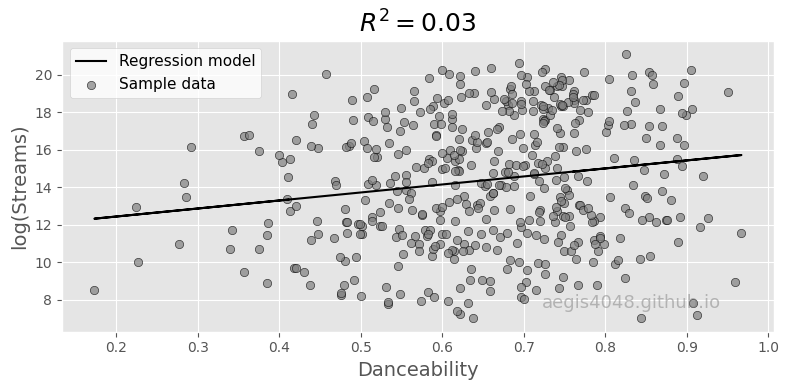

In [477]:
X = sum_dat['danceability'].values.reshape(-1,1)
y = np.log(sum_dat['Streams'].values)

ols = LinearRegression()
model = ols.fit(X, y)
response = model.predict(X)

r2 = model.score(X, y)

plt.style.use('default')
plt.style.use('ggplot')

fig, ax = plt.subplots(figsize=(8, 4))

ax.plot(X, response, color='k', label='Regression model')
ax.scatter(X, y, edgecolor='k', facecolor='grey', alpha=0.7, label='Sample data')
ax.set_ylabel('log(Streams)', fontsize=14)
ax.set_xlabel('Danceability', fontsize=14)
ax.text(0.8, 0.1, 'aegis4048.github.io', fontsize=13, ha='center', va='center',
         transform=ax.transAxes, color='grey', alpha=0.5)
ax.legend(facecolor='white', fontsize=11)
ax.set_title('$R^2= %.2f$' % r2, fontsize=18)

fig.tight_layout()

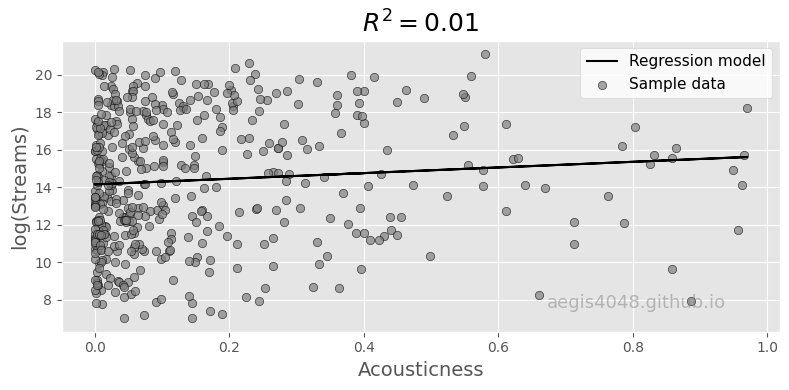

In [478]:
X = sum_dat['acousticness'].values.reshape(-1,1)
y = np.log(sum_dat['Streams'].values)

ols = LinearRegression()
model = ols.fit(X, y)
response = model.predict(X)

r2 = model.score(X, y)

plt.style.use('default')
plt.style.use('ggplot')

fig, ax = plt.subplots(figsize=(8, 4))

ax.plot(X, response, color='k', label='Regression model')
ax.scatter(X, y, edgecolor='k', facecolor='grey', alpha=0.7, label='Sample data')
ax.set_ylabel('log(Streams)', fontsize=14)
ax.set_xlabel('Acousticness', fontsize=14)
ax.text(0.8, 0.1, 'aegis4048.github.io', fontsize=13, ha='center', va='center',
         transform=ax.transAxes, color='grey', alpha=0.5)
ax.legend(facecolor='white', fontsize=11)
ax.set_title('$R^2= %.2f$' % r2, fontsize=18)

fig.tight_layout()

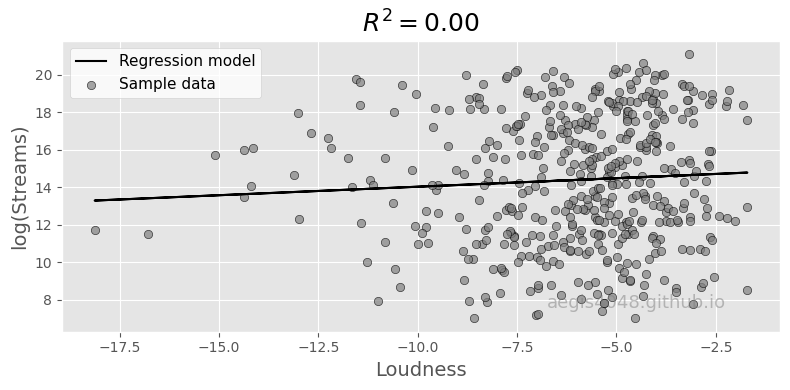

In [479]:
X = sum_dat['loudness'].values.reshape(-1,1)
y = np.log(sum_dat['Streams'].values)

ols = LinearRegression()
model = ols.fit(X, y)
response = model.predict(X)

r2 = model.score(X, y)

plt.style.use('default')
plt.style.use('ggplot')

fig, ax = plt.subplots(figsize=(8, 4))

ax.plot(X, response, color='k', label='Regression model')
ax.scatter(X, y, edgecolor='k', facecolor='grey', alpha=0.7, label='Sample data')
ax.set_ylabel('log(Streams)', fontsize=14)
ax.set_xlabel('Loudness', fontsize=14)
ax.text(0.8, 0.1, 'aegis4048.github.io', fontsize=13, ha='center', va='center',
         transform=ax.transAxes, color='grey', alpha=0.5)
ax.legend(facecolor='white', fontsize=11)
ax.set_title('$R^2= %.2f$' % r2, fontsize=18)

fig.tight_layout()

# Comparing Personal Discography Musical Characteristics to US Charting Songs

In [481]:
import spotipy 
sp = spotipy.Spotify() 
from spotipy.oauth2 import SpotifyClientCredentials 
cid ="1c707738f91f4e3dbd5f3015af258bf9" 
secret = "5b87fc20c03d4e039e64fae383247e97" 
client_credentials_manager = SpotifyClientCredentials(client_id=cid, client_secret=secret) 
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager) 
sp.trace=False 


In [482]:
sp.user_playlists('fhuy3kc19d6uvcge8yrw6fng6')

{'href': 'https://api.spotify.com/v1/users/fhuy3kc19d6uvcge8yrw6fng6/playlists?offset=0&limit=50',
 'items': [{'collaborative': False,
   'description': '',
   'external_urls': {'spotify': 'https://open.spotify.com/playlist/5hsY63BTUvDbXgmzfHWz8v'},
   'href': 'https://api.spotify.com/v1/playlists/5hsY63BTUvDbXgmzfHWz8v',
   'id': '5hsY63BTUvDbXgmzfHWz8v',
   'images': [{'height': 640,
     'url': 'https://mosaic.scdn.co/640/ab67616d0000b27334018666aa85f2ba0bd4f368ab67616d0000b27367d56b8df074a11a6f352ba4ab67616d0000b273af82098b26f1a3d2ffce8046ab67616d0000b273b9ebcdb7e66f25f5556e232b',
     'width': 640},
    {'height': 300,
     'url': 'https://mosaic.scdn.co/300/ab67616d0000b27334018666aa85f2ba0bd4f368ab67616d0000b27367d56b8df074a11a6f352ba4ab67616d0000b273af82098b26f1a3d2ffce8046ab67616d0000b273b9ebcdb7e66f25f5556e232b',
     'width': 300},
    {'height': 60,
     'url': 'https://mosaic.scdn.co/60/ab67616d0000b27334018666aa85f2ba0bd4f368ab67616d0000b27367d56b8df074a11a6f352ba4ab67616

In [483]:
playlist = sp.user_playlist("fhuy3kc19d6uvcge8yrw6fng6", "4Abs2Ey8vgdxy81aSMReQt") 
songs = playlist["tracks"]["items"] 

ids = [] 
for i in range(len(songs)): 
    ids.append(songs[i]["track"]["id"]) 
features = sp.audio_features(ids) 
sam_df = pd.DataFrame(features)

track_names = []
artist_names = []
for song in songs:
    track_names.append(song['track']['name'])
    artist_names.append(song['track']['artists'][0]['name'])

sam_df['Track Name'] = track_names
sam_df['Artist'] = artist_names


In [484]:
playlist2 = sp.user_playlist("fhuy3kc19d6uvcge8yrw6fng6", "5hsY63BTUvDbXgmzfHWz8v") 
songs = playlist2["tracks"]["items"] 

ids = [] 
for i in range(len(songs)): 
    ids.append(songs[i]["track"]["id"]) 
features = sp.audio_features(ids) 
sam_df2 = pd.DataFrame(features)

track_names = []
artist_names = []
for song in songs:
    track_names.append(song['track']['name'])
    artist_names.append(song['track']['artists'][0]['name'])

sam_df2['Track Name'] = track_names
sam_df2['Artist'] = artist_names


In [485]:
sam_df2.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,Track Name,Artist
0,0.397,0.185,9,-13.055,1,0.0516,0.8340,0.000,0.0961,0.335,79.898,audio_features,48c4tRmj3n77u3NOpnHmma,spotify:track:48c4tRmj3n77u3NOpnHmma,https://api.spotify.com/v1/tracks/48c4tRmj3n77...,https://api.spotify.com/v1/audio-analysis/48c4...,57070,4,Arsonists,Manuka Piglet
1,0.672,0.608,2,-8.857,1,0.0822,0.7820,0.925,0.1070,0.375,110.081,audio_features,6T93SjM5SjnfJUhawxiX3X,spotify:track:6T93SjM5SjnfJUhawxiX3X,https://api.spotify.com/v1/tracks/6T93SjM5Sjnf...,https://api.spotify.com/v1/audio-analysis/6T93...,138560,4,The Floor Is Cold and Hard,S.J. Roberts
2,0.398,0.900,0,-0.742,1,0.1000,0.0415,0.000,0.4530,0.766,119.878,audio_features,7dSGKntTB7Y4193a0PoIsd,spotify:track:7dSGKntTB7Y4193a0PoIsd,https://api.spotify.com/v1/tracks/7dSGKntTB7Y4...,https://api.spotify.com/v1/audio-analysis/7dSG...,95070,4,Music Is the Thing,S.J. Roberts
3,0.177,0.981,11,0.904,0,0.1550,0.0949,0.357,0.0736,0.216,164.906,audio_features,5DIL3r4zW2P4vnUTiB22cw,spotify:track:5DIL3r4zW2P4vnUTiB22cw,https://api.spotify.com/v1/tracks/5DIL3r4zW2P4...,https://api.spotify.com/v1/audio-analysis/5DIL...,548200,4,First-Course Postworld,S.J. Roberts
4,0.339,0.819,8,-6.592,0,0.0637,0.4330,0.163,0.1410,0.444,61.392,audio_features,5wG7HLWlsjrVZHwOJQnTBp,spotify:track:5wG7HLWlsjrVZHwOJQnTBp,https://api.spotify.com/v1/tracks/5wG7HLWlsjrV...,https://api.spotify.com/v1/audio-analysis/5wG7...,94130,4,Trouble at Bat Castle,S.J. Roberts


In [486]:
frames = [sam_df,sam_df2]
sam_df = pd.concat(frames)

In [487]:
sam_df.to_csv('sam_discography_data.csv', encoding='utf-8')

In [488]:
sam_df.drop('type', axis=1, inplace=True)
sam_df.drop('id', axis=1, inplace=True)
sam_df.drop('uri', axis=1, inplace=True)
sam_df.drop('track_href', axis=1, inplace=True)
sam_df.drop('analysis_url', axis=1, inplace=True)

In [489]:
sam_df.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,Track Name,Artist
0,0.403,0.0322,5,-18.682,1,0.0453,0.9210,0.024300,0.3440,0.217,112.948,78874,4,Oh My Love (Theme),John King Cave
1,0.519,0.5820,0,-9.143,1,0.0302,0.5400,0.000037,0.1040,0.514,105.562,216098,4,Lovey Baby,John King Cave
2,0.582,0.7990,9,-5.820,1,0.0746,0.0529,0.011500,0.0656,0.501,120.430,290479,4,Goin' Out There,John King Cave
3,0.302,0.5890,0,-10.941,1,0.0452,0.3380,0.041600,0.1040,0.558,205.867,169265,4,True Love,John King Cave
4,0.448,0.3980,2,-10.007,1,0.0301,0.2960,0.006000,0.0996,0.189,122.277,440377,4,Just for a Moment,John King Cave


In [490]:
# Compare musical characteristic distributions between US and Sam datasets

cols = ['acousticness',
       'danceability', 'duration_ms', 'energy', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=4,cols=3,
                   subplot_titles=('acousticness','instrumentalness','mode',
                                   'speechiness','danceability','key',
                                   'liveness','tempo','duration_ms',
                                   'energy','loudness','valence'))
traces = []

index = 1
for col in cols:
    
    tracea = go.Histogram(x=us_dat[col],name='US',marker_color='red',bingroup=index)
    traceb = go.Histogram(x=sam_df[col],name='Sam',marker_color='blue',bingroup=index)
    traces.append((tracea,traceb))
    index +=1
    
for i in range(12):
    fig.append_trace(traces[i][0],(i%4)+1,(i%3)+1)
    fig.append_trace(traces[i][1],(i%4)+1,(i%3)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='US Chart Topping Songs vs. Sam\'s Songs Musical Characteristics'
)

fig.show()

In [491]:
# Compare musical characteristic distributions between Global and Sam datasets

cols = ['acousticness',
       'danceability', 'duration_ms', 'energy', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'speechiness', 'tempo',
       'valence']

fig = make_subplots(rows=4,cols=3,
                   subplot_titles=('acousticness','instrumentalness','mode',
                                   'speechiness','danceability','key',
                                   'liveliness','tempo','duration_ms',
                                   'energy','loudness','valence'))
traces = []

index = 1
for col in cols:

    tracea = go.Histogram(x=sum_dat[col],name='Global',marker_color='red',bingroup=index)
    traceb = go.Histogram(x=sam_df[col],name='Sam',marker_color='blue',bingroup=index)
    traces.append((tracea,traceb))
    index +=1
    
for i in range(12):
    fig.append_trace(traces[i][0],(i%4)+1,(i%3)+1)
    fig.append_trace(traces[i][1],(i%4)+1,(i%3)+1)
    
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)    

names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))

fig.update_layout(
    title_text='Globally Chart Topping Songs vs. Sam\'s Songs Musical Characteristics'
)

fig.show()

# Future Work

Webscrape data for chart-topping songs over greater period of time, determine how popular song attributes have changed over time.